In [1]:
import sqlite3
from sklearn.feature_extraction.text import TfidfVectorizer
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from wordcloud import WordCloud

In [2]:
def to_json_list(cursor):
    results = cursor.fetchall()
    headers = [d[0] for d in cursor.description]
    return [dict(zip(headers, row)) for row in results]

In [3]:
# 結局使ってない。
# def tokenize(document):
#     tokens = [w for w in document.split()]
#     if len(tokens) <= 2:
#         return []
#     return tokens

In [4]:
conn = sqlite3.connect('speech.db')

In [5]:
all = pd.read_sql_query(f'''SELECT * FROM speech''', conn)
tfidf = TfidfVectorizer(
                    use_idf=True, 
                    norm='l2', 
                    smooth_idf=True,
                    max_features=5000
                    )    
tf = tfidf.fit_transform(all["speech"])
weights = sorted([(word, tf.getcol(idx).sum()) for word, idx in tfidf.vocabulary_.items()], key=lambda item: item[1], reverse=True)

In [6]:
weights

[('大臣', 24690.961082417456),
 ('質問', 19736.280850552343),
 ('問題', 19519.847572872477),
 ('日本', 13857.143294682533),
 ('必要', 12620.306544154992),
 ('お願い', 12343.759050507444),
 ('伺い', 11913.883322052088),
 ('答弁', 11736.373886594334),
 ('非常', 11464.183536639113),
 ('議論', 11360.13293685903),
 ('状況', 10938.527865056829),
 ('制度', 10706.776672283031),
 ('政府', 10355.140415853619),
 ('国民', 10340.70172141471),
 ('大変', 10121.340626326364),
 ('いかが', 9919.296908523625),
 ('総理', 9641.20574805244),
 ('考え', 9097.117820186037),
 ('法案', 8890.19431046939),
 ('対応', 8847.414667690142),
 ('説明', 8673.09331713705),
 ('意味', 8566.759574073336),
 ('地域', 8040.378221401988),
 ('皆さん', 8008.177817410513),
 ('お話', 7700.515829145387),
 ('検討', 7638.196113252514),
 ('調査', 7590.338365123904),
 ('対策', 7547.771650375405),
 ('意見', 7438.507682545356),
 ('確認', 7402.961188954334),
 ('支援', 7337.770329215273),
 ('お答え', 7304.5340164454465),
 ('事業', 7059.63094135874),
 ('予算', 6967.584487124515),
 ('最後', 6933.964672131484),
 ('方々'

In [7]:
top130_stop_words = []
for i in range(130):
    s = weights[i][0]
    top130_stop_words.append(s)

In [8]:
non_stopwords = ['アメリカ','地域','地方','企業','自治体','子供','教育','民間','環境','経済','行政','数字','職員','会社','医療','年金','中国']

stop_words = set(top130_stop_words) - set(non_stopwords)
stop_words = list(stop_words)

In [9]:
stop_words

['委員会',
 'お話',
 '最後',
 '具体的',
 '委員長',
 '審議',
 '方々',
 '答弁',
 '認識',
 '平成',
 '対応',
 '部分',
 '社会',
 '思い',
 '内容',
 '規定',
 '取組',
 '国会',
 '政策',
 '負担',
 '議員',
 '具体',
 '提出',
 '評価',
 '推進',
 'では',
 '副大臣',
 '被害',
 '実施',
 '責任',
 '確保',
 'いかが',
 '世界',
 '調査',
 '意見',
 '改革',
 '資料',
 '目的',
 '参考',
 '観点',
 '我が国',
 '利用',
 '指摘',
 'お金',
 '先ほど',
 '予算',
 'お願い',
 '大変',
 '重要',
 '整備',
 '見解',
 '国民',
 '明らか',
 '皆さん',
 '先生',
 'お尋ね',
 '基準',
 '支援',
 '現場',
 '地元',
 '体制',
 '質問',
 '問題',
 '実態',
 '日本',
 '理由',
 '改正',
 '情報',
 '意味',
 '発言',
 '議論',
 '対策',
 '法律',
 '理解',
 '状況',
 '提案',
 '措置',
 '影響',
 '大事',
 '努力',
 '最初',
 '報道',
 '非常',
 '言葉',
 '委員',
 '規制',
 '立場',
 '法案',
 '伺い',
 '計画',
 '制度',
 '大臣',
 '検討',
 '是非',
 '総理',
 '事業',
 '説明',
 '十分',
 '参考人',
 '施設',
 'お答え',
 '対象',
 '判断',
 '確認',
 '私たち',
 '質疑',
 '報告',
 '現状',
 '課題',
 '考え',
 '政府',
 '考え方',
 '必要']

In [10]:
concat_after_stopwords = pd.DataFrame(0, index=np.arange(5000), columns=[str(y) for y in range(2002, 2023)])
for y in range(2002, 2023):
    all = pd.read_sql_query(f'''SELECT * FROM speech WHERE speech_date >= '{y}-01-01' AND speech_date <= '{y}-12-31' ''', conn)
    tfidf = TfidfVectorizer(
                        use_idf=True, 
                        norm='l2', 
                        smooth_idf=True,
                        max_features=5000,
                        stop_words=stop_words
                        )    
    tf = tfidf.fit_transform(all["speech"])
    all_weights = sorted([(word, tf.getcol(idx).sum()) for word, idx in tfidf.vocabulary_.items()], key=lambda item: item[1], reverse=True)
    concat_after_stopwords[f"{y}"] = all_weights

In [11]:
all = pd.read_sql_query(f'''SELECT * FROM speech''', conn)
tfidf = TfidfVectorizer(
                        use_idf=True, 
                        norm='l2', 
                        smooth_idf=True,
                        max_features=5000,
                        stop_words=stop_words
                        )      
tf = tfidf.fit_transform(all["speech"])
all_weights = sorted([(word, tf.getcol(idx).sum()) for word, idx in tfidf.vocabulary_.items()], key=lambda item: item[1], reverse=True)
concat_after_stopwords["all_year"] = all_weights

In [12]:
concat_after_stopwords.to_csv('TF-IDF_after_stopwords.csv')

In [13]:
concat_after_stopwords["2022"]

0          (地域, 238.36338397947043)
1       (ウクライナ, 237.51427177439112)
2         (ロシア, 231.18132662241905)
3          (経済, 223.25076649411298)
4         (自治体, 204.52685268625623)
                   ...             
4995      (無所属, 2.3925591750284134)
4996     (国民主権, 2.3808809211259807)
4997       (商業地, 2.243714207133091)
4998        (不払, 2.079908994576719)
4999       (第五, 1.9445570525685352)
Name: 2022, Length: 5000, dtype: object

2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021


/var/folders/f4/d26fc2lx7y5d0rs_6sbh_b2h0000gn/T/ipykernel_66478/2439382510.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(20,15))


2022


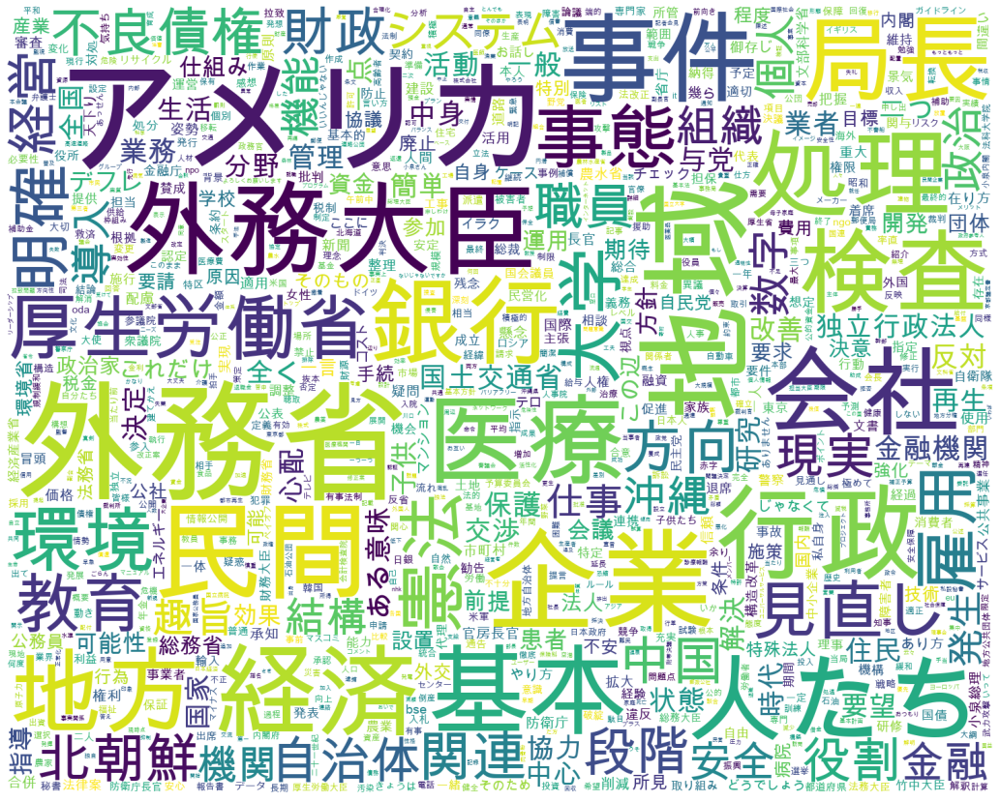

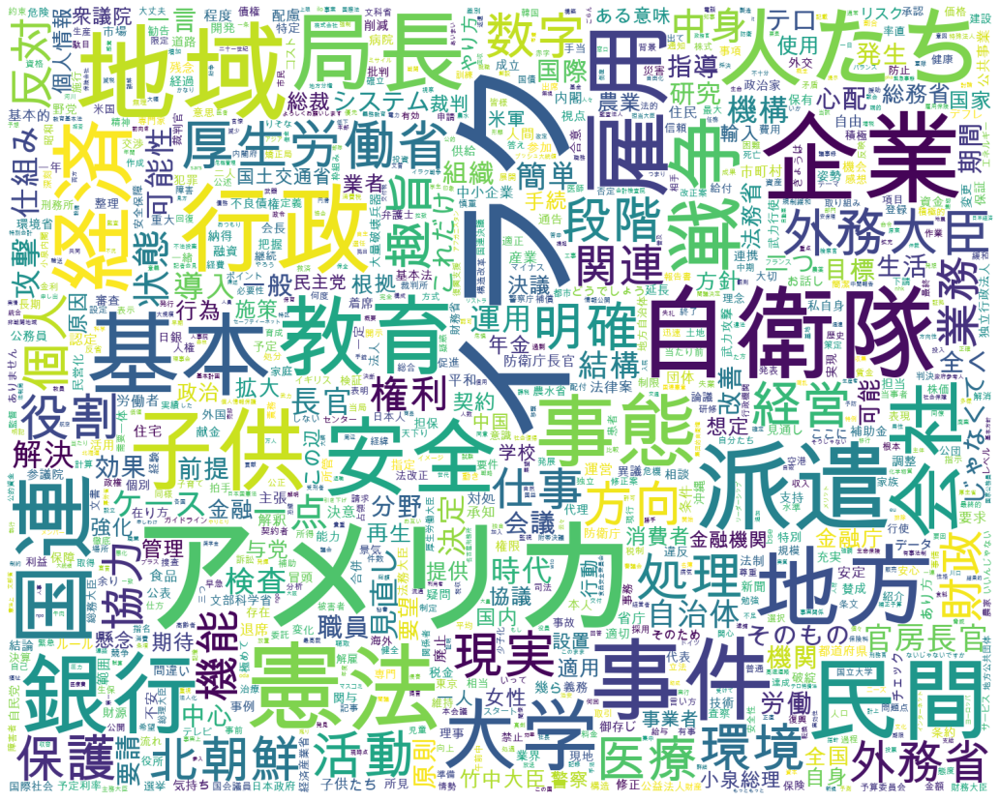

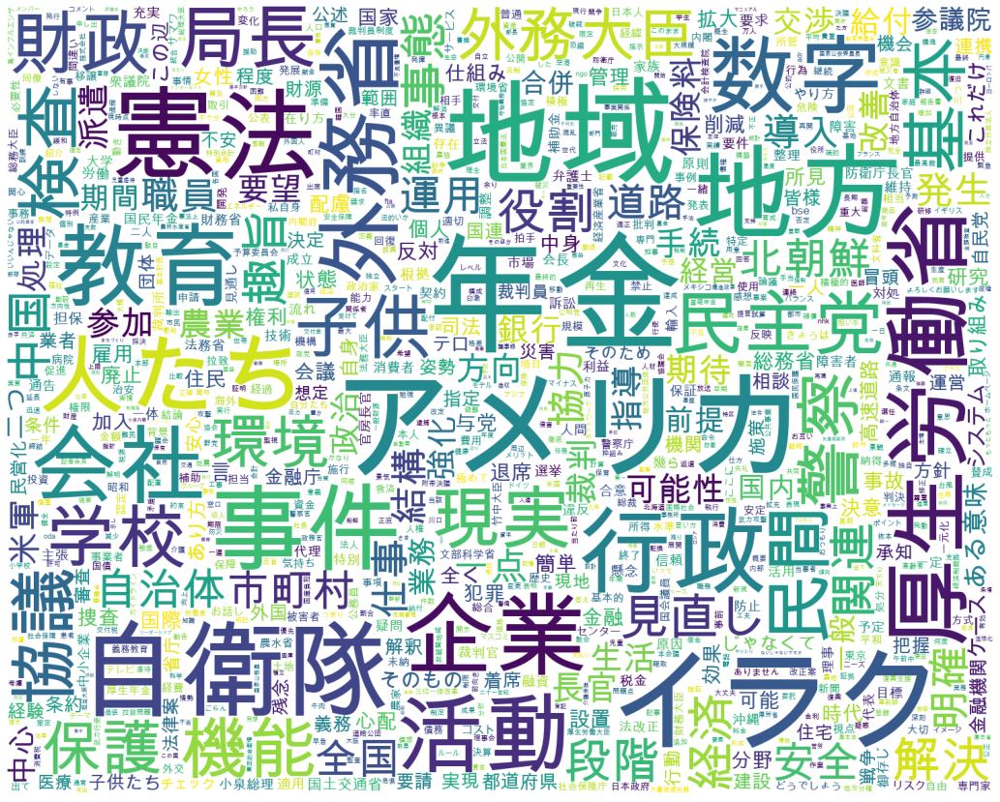

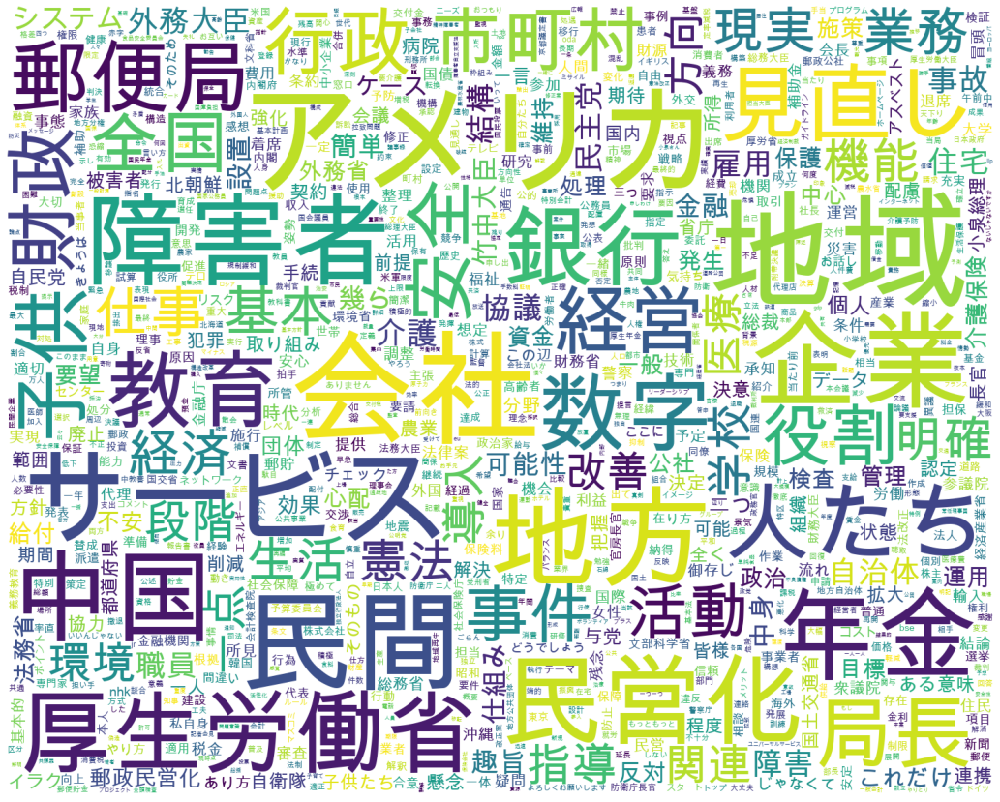

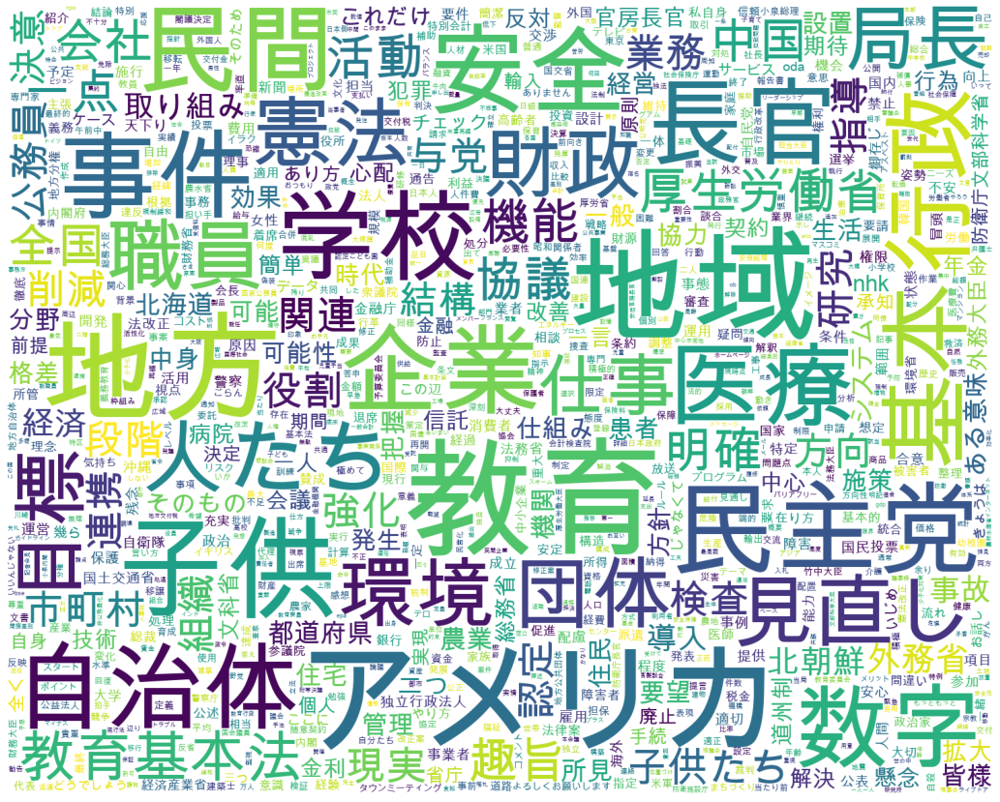

...

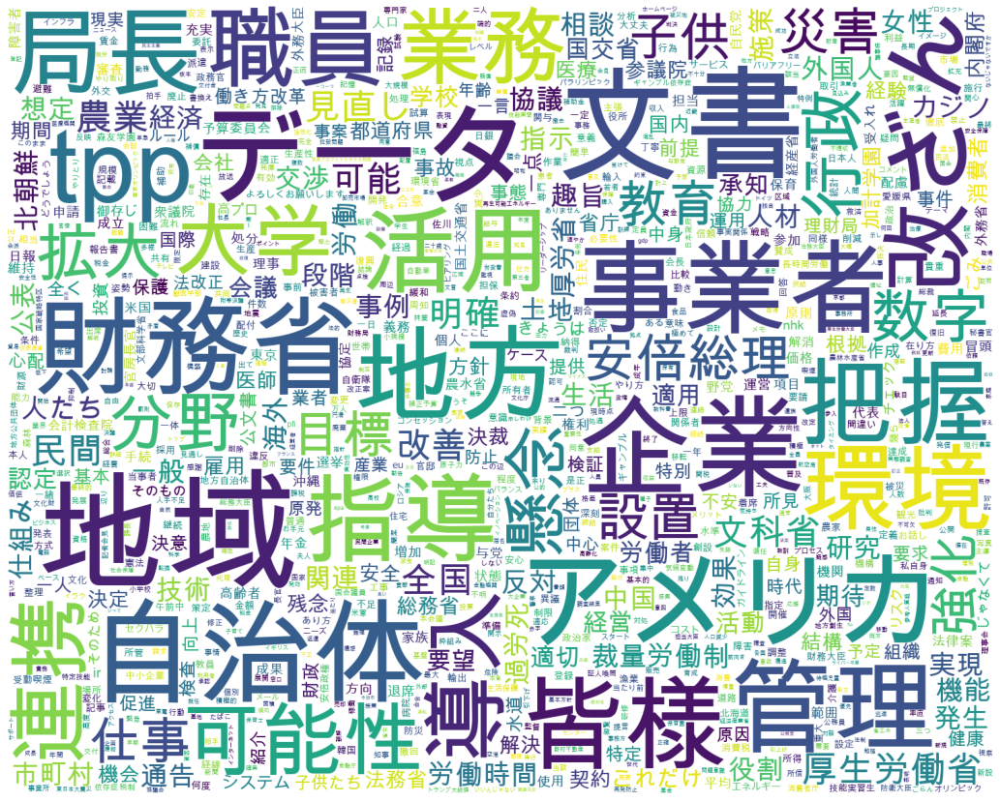

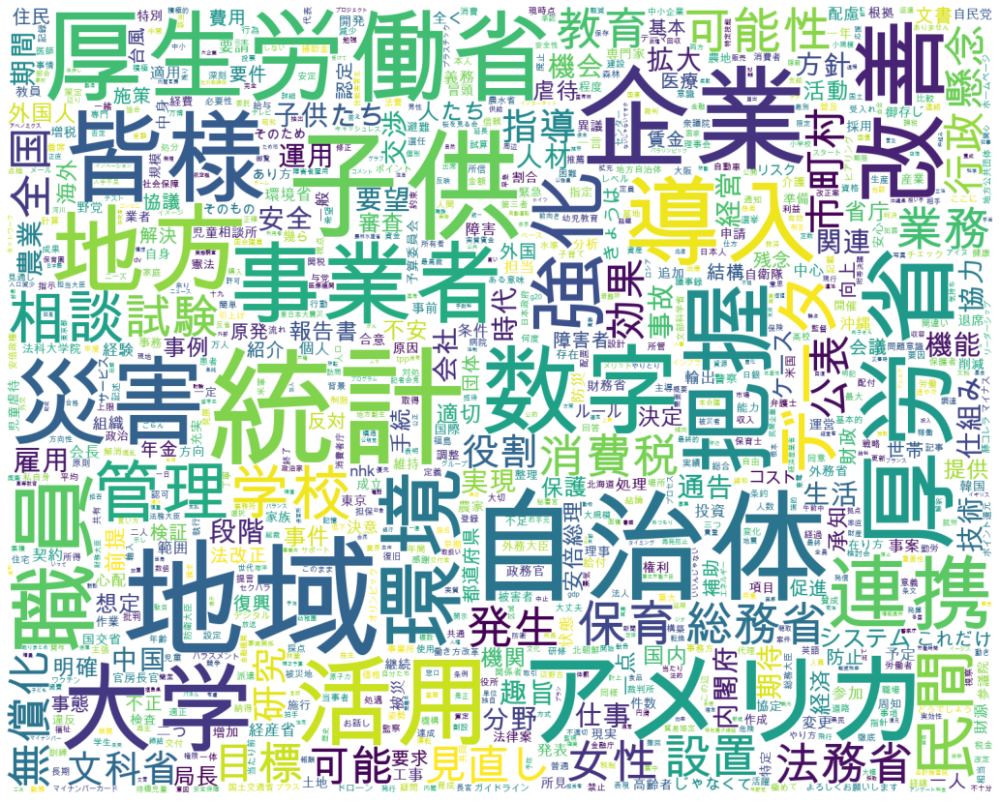

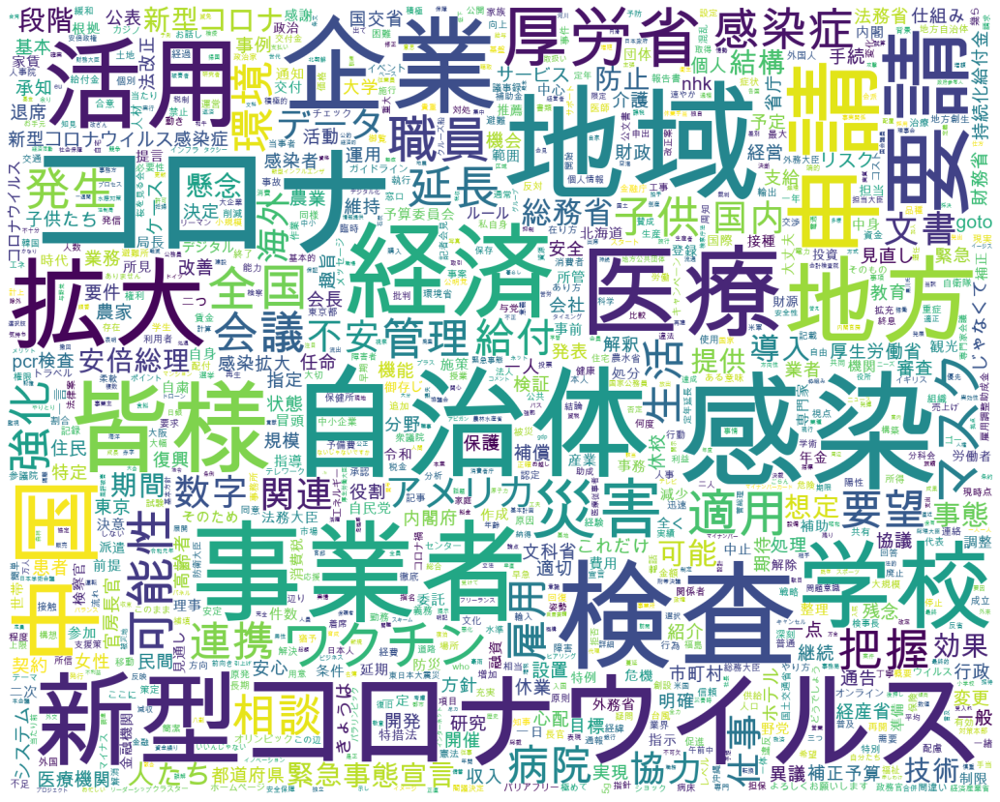

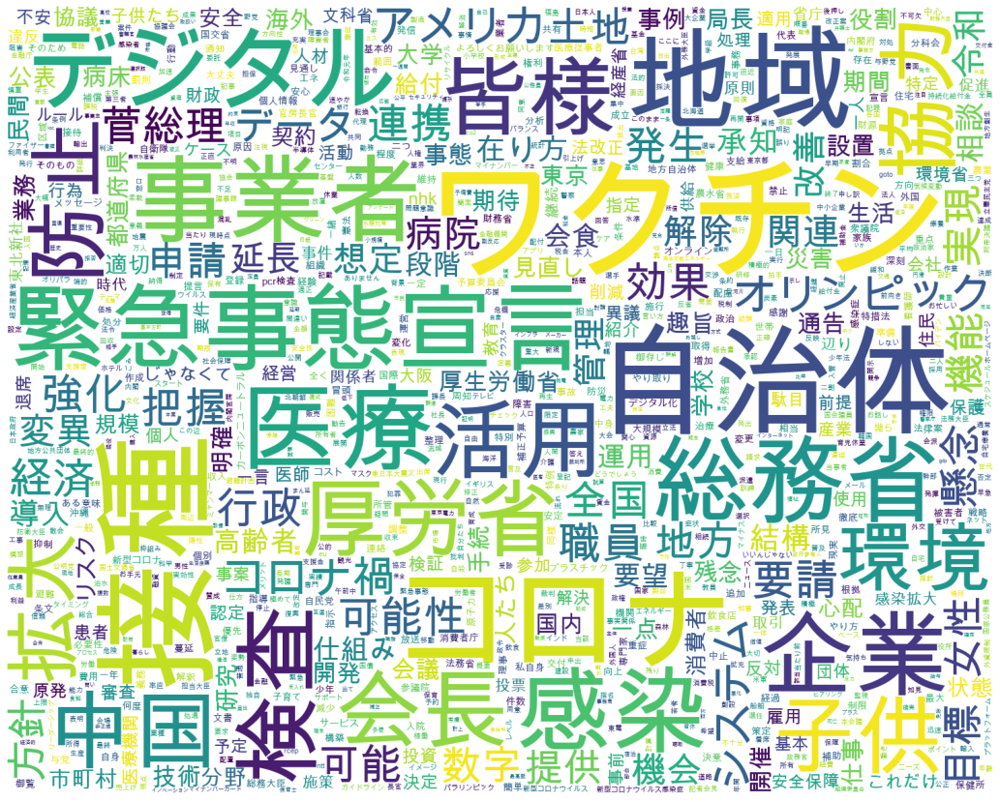

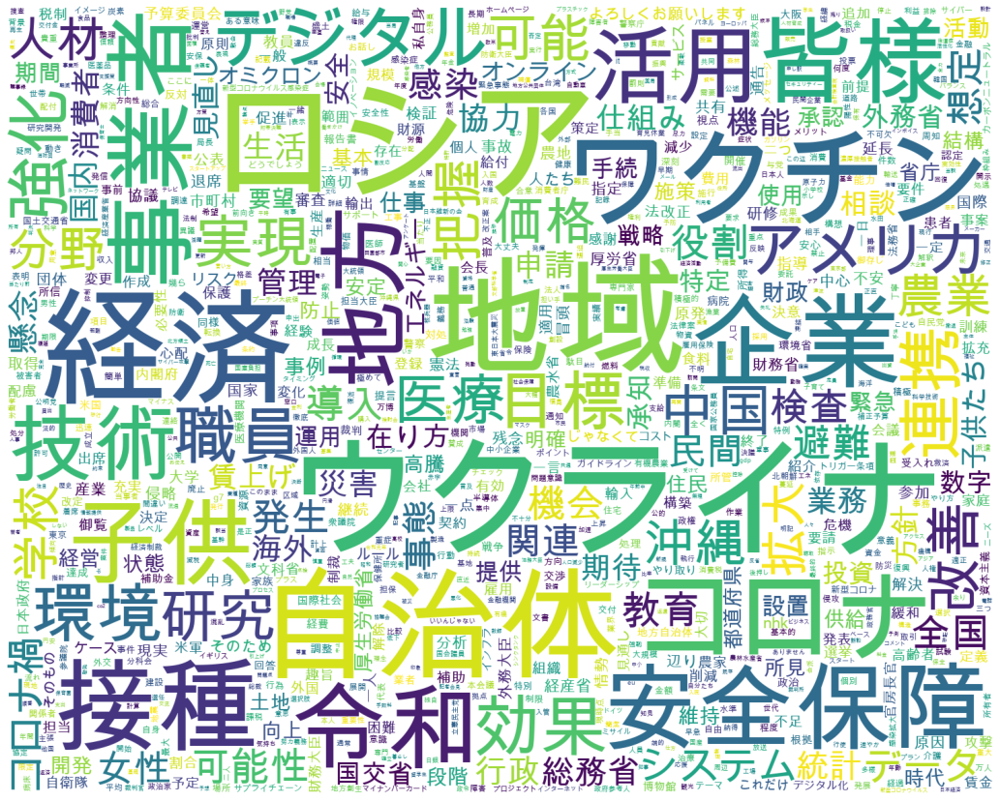

In [14]:
word_clouds = []
for y in range(2002, 2023):
    w = WordCloud(width=1500, height=1200, mode='RGBA', background_color='white', \
     font_path='/Library/Fonts/Arial Unicode.ttf', max_words=1000, max_font_size=200\
         ).fit_words(dict(concat_after_stopwords[str(y)].to_list()))
    word_clouds.append(w)
    plt.figure(figsize=(20,15))
    print(str(y))
    plt.imshow(w)
    plt.axis('off')

In [15]:
textfile = open("stopwords_defined.txt", "w")
for element in stop_words:
    textfile.write(element + "\n")
textfile.close()